## Imports

In [10]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
plt.style.use('fivethirtyeight')  

In [11]:
neighborhoodBranchInfo_Demos = pd.read_csv('../data/dani data/neighborhoodbranchinfo_demos (1).csv')
demosDFAverageWalkingNeighborhoods = pd.read_csv('../data/dani data/demosdfaveragewalkingneighborhood__2_.csv')

## Creating Correlation Matricies

In [12]:
demosDFAverageWalkingNeighborhoods['Branch'] = demosDFAverageWalkingNeighborhoods['Branch'].replace(['Woodson Regional Library'],'Woodson Regional')
demosDFAverageWalkingNeighborhoods
demosWT = demosDFAverageWalkingNeighborhoods.set_index('Branch')
demosWT

,WT: White,WT: Black or African American,WT: Degree: High School or More,WT: Degree: Some College or More,WT: Degree: Bachelors or More,WT: Degree: Masters or More,WT: At or Above Poverty,WT: In Poverty,"WT: Income: $150,000 to $199,999",WT: Employed,WT: Unemployed,WT: Has Internet Access,WT: Has No Internet Access,WT: Has Computer,WT: Has No Computer,"WT: Transportation: Car, Truck, or Van"
Branch,,,,,,,,,,,,,,,,
Albany Park,13.512148,12.330002,13.360455,13.473946,13.522903,13.651916,13.286265,12.814560,13.185646,13.237075,13.074797,13.142420,14.101417,13.139007,15.122548,13.553848
Altgeld,21.039918,18.642701,18.806226,19.047968,20.185649,19.556910,19.358786,18.219063,20.409599,19.072247,18.093558,18.829925,18.857423,18.831050,18.865243,19.051936
Archer Heights,15.113948,20.253843,15.405473,15.848438,16.446517,17.037708,15.300580,16.862996,14.486240,15.489046,14.905099,15.484672,15.169390,15.490422,15.102175,15.661687
Austin,17.027949,13.965169,14.981748,15.633921,17.022530,17.169104,15.401435,12.843789,19.727664,15.072552,13.247070,15.213131,13.028244,15.193525,12.392712,14.675703
Austin-Irving,13.616476,13.565469,13.414610,13.484629,13.595912,13.819422,13.390786,14.067914,13.080432,13.408938,13.921287,13.329957,14.093260,13.413432,13.689344,13.405418
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
West Pullman,22.727794,19.050420,19.392102,19.644891,20.085048,20.448190,19.555006,18.797498,20.229178,19.553768,18.776435,19.571257,18.660730,19.527600,18.533287,19.331958
West Town,11.753601,11.801216,11.664222,11.637999,11.583830,11.582402,11.631369,11.961131,11.546561,11.657784,11.597475,11.441156,10.981453,11.769071,10.459057,11.739559
"Whitney M. Young, Jr.",16.861131,15.067852,15.014423,14.974124,15.334699,14.443835,15.066578,14.818756,13.905468,14.954432,15.294596,15.071008,14.791202,14.991331,15.128007,15.305011


In [13]:
#Dropping unnecessary column and setting index to be library branches
corrMatrixInfo = neighborhoodBranchInfo_Demos.drop(columns=['Unnamed: 0']).set_index('Branch')
corrMatrixInfo

,CIRCULATION_2019,COMPUTER SESSIONS_2019,VISITORS_2019,AVG COMPUTER SESSIONS PER VISITOR_2019,AVG CIRCULATION PER VISITOR_2019,CIRCULATION_2021,COMPUTER SESSIONS_2021,VISITORS_2021,AVG COMPUTER SESSIONS PER VISITOR_2021,AVG CIRCULATION PER VISITOR_2021,...,Percent: 75 to 79 years,Percent: 80 to 84 years,Percent: 85 years and over,Percent: 25+ Less Than High School,Percent: 25+ High School or More,Percent: 25+ Some College or More,Percent: 25+ Bachelor's Degree or More,Percent: 25+ Master's Degree or More,Percent: 25+ Professional School Degree or More,Percent: 25+ Doctorate Degree
Branch,,,,,,,,,,,,,,,,,,,,,
Albany Park,93009.0,23279.0,130255.0,0.178719,0.714053,61634.0,8838.0,62840.0,0.140643,0.980808,...,0.018738,0.012502,0.014624,0.198831,0.801169,0.610342,0.424586,0.154549,0.039779,0.016641
Altgeld,4014.0,5226.0,28196.0,0.185345,0.142361,1934.0,6719.0,10760.0,0.624442,0.179740,...,0.006495,0.006306,0.009861,0.131738,0.868262,0.514783,0.081321,0.035143,0.001320,0.000387
Archer Heights,58025.0,17466.0,86593.0,0.201702,0.670089,26320.0,7223.0,34665.0,0.208366,0.759267,...,0.028363,0.011774,0.022845,0.272545,0.727455,0.351427,0.142880,0.038570,0.004559,0.002552
Austin,11328.0,16288.0,77480.0,0.210222,0.146205,7108.0,8554.0,35321.0,0.242179,0.201240,...,0.029010,0.021235,0.010137,0.116860,0.883140,0.563836,0.269374,0.129586,0.031410,0.012350
Austin-Irving,119100.0,16115.0,109080.0,0.147736,1.091859,62934.0,5423.0,48720.0,0.111310,1.291749,...,0.031729,0.015801,0.021996,0.103526,0.896474,0.599678,0.301220,0.103562,0.027182,0.013603
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Wrightwood-Ashburn,17607.0,12697.0,47353.0,0.268135,0.371824,6840.0,4584.0,12274.0,0.373472,0.557276,...,0.028922,0.012624,0.016501,0.115282,0.884718,0.616149,0.259722,0.100758,0.017647,0.008545
Douglass,NaN,NaN,NaN,NaN,NaN,4852.0,7210.0,8045.0,0.896209,0.603108,...,0.014068,0.009775,0.011324,0.185578,0.814422,0.490588,0.152965,0.060742,0.015225,0.010500
Water Works,NaN,NaN,NaN,NaN,NaN,8516.0,306.0,10594.0,0.028884,0.803851,...,0.027358,0.016356,0.020095,0.010421,0.989579,0.951998,0.865238,0.448610,0.193363,0.053186


In [7]:
#MatrixInfoWithWT = demosWT.merge(corrMatrixInfo, how = 'outer', on= 'Branch')
#MatrixInfoWithWT

,WT: White,WT: Black or African American,WT: Degree: High School or More,WT: Degree: Some College or More,WT: Degree: Bachelors or More,WT: Degree: Masters or More,WT: At or Above Poverty,WT: In Poverty,"WT: Income: $150,000 to $199,999",WT: Employed,...,Percent: 75 to 79 years,Percent: 80 to 84 years,Percent: 85 years and over,Percent: 25+ Less Than High School,Percent: 25+ High School or More,Percent: 25+ Some College or More,Percent: 25+ Bachelor's Degree or More,Percent: 25+ Master's Degree or More,Percent: 25+ Professional School Degree or More,Percent: 25+ Doctorate Degree
Branch,,,,,,,,,,,,,,,,,,,,,
Albany Park,13.512148,12.330002,13.360455,13.473946,13.522903,13.651916,13.286265,12.814560,13.185646,13.237075,...,0.018738,0.012502,0.014624,0.198831,0.801169,0.610342,0.424586,0.154549,0.039779,0.016641
Altgeld,21.039918,18.642701,18.806226,19.047968,20.185649,19.556910,19.358786,18.219063,20.409599,19.072247,...,0.006495,0.006306,0.009861,0.131738,0.868262,0.514783,0.081321,0.035143,0.001320,0.000387
Archer Heights,15.113948,20.253843,15.405473,15.848438,16.446517,17.037708,15.300580,16.862996,14.486240,15.489046,...,0.028363,0.011774,0.022845,0.272545,0.727455,0.351427,0.142880,0.038570,0.004559,0.002552
Austin,17.027949,13.965169,14.981748,15.633921,17.022530,17.169104,15.401435,12.843789,19.727664,15.072552,...,0.029010,0.021235,0.010137,0.116860,0.883140,0.563836,0.269374,0.129586,0.031410,0.012350
Austin-Irving,13.616476,13.565469,13.414610,13.484629,13.595912,13.819422,13.390786,14.067914,13.080432,13.408938,...,0.031729,0.015801,0.021996,0.103526,0.896474,0.599678,0.301220,0.103562,0.027182,0.013603
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
West Town,11.753601,11.801216,11.664222,11.637999,11.583830,11.582402,11.631369,11.961131,11.546561,11.657784,...,0.007910,0.006681,0.003895,0.043311,0.956689,0.882720,0.755561,0.289658,0.093000,0.028663
"Whitney M. Young, Jr.",16.861131,15.067852,15.014423,14.974124,15.334699,14.443835,15.066578,14.818756,13.905468,14.954432,...,0.019355,0.030249,0.026753,0.112408,0.887592,0.652410,0.273651,0.107609,0.028019,0.008521
Woodson Regional,17.083157,16.748017,16.810851,16.770676,16.381895,16.113057,16.841675,16.394362,14.124642,16.645222,...,0.025893,0.030445,0.039622,0.111294,0.888706,0.623501,0.256464,0.103263,0.010696,0.006081


In [14]:
#Redefining dataframe that will eventually be split into two seperate correlation matricies (since there are too many variables to fit in one matrix)
corrMatrixInfo1 = corrMatrixInfo.iloc[:,0:88]
corrMatrixInfo1

,CIRCULATION_2019,COMPUTER SESSIONS_2019,VISITORS_2019,AVG COMPUTER SESSIONS PER VISITOR_2019,AVG CIRCULATION PER VISITOR_2019,CIRCULATION_2021,COMPUTER SESSIONS_2021,VISITORS_2021,AVG COMPUTER SESSIONS PER VISITOR_2021,AVG CIRCULATION PER VISITOR_2021,...,Percent: 75 to 79 years,Percent: 80 to 84 years,Percent: 85 years and over,Percent: 25+ Less Than High School,Percent: 25+ High School or More,Percent: 25+ Some College or More,Percent: 25+ Bachelor's Degree or More,Percent: 25+ Master's Degree or More,Percent: 25+ Professional School Degree or More,Percent: 25+ Doctorate Degree
Branch,,,,,,,,,,,,,,,,,,,,,
Albany Park,93009.0,23279.0,130255.0,0.178719,0.714053,61634.0,8838.0,62840.0,0.140643,0.980808,...,0.018738,0.012502,0.014624,0.198831,0.801169,0.610342,0.424586,0.154549,0.039779,0.016641
Altgeld,4014.0,5226.0,28196.0,0.185345,0.142361,1934.0,6719.0,10760.0,0.624442,0.179740,...,0.006495,0.006306,0.009861,0.131738,0.868262,0.514783,0.081321,0.035143,0.001320,0.000387
Archer Heights,58025.0,17466.0,86593.0,0.201702,0.670089,26320.0,7223.0,34665.0,0.208366,0.759267,...,0.028363,0.011774,0.022845,0.272545,0.727455,0.351427,0.142880,0.038570,0.004559,0.002552
Austin,11328.0,16288.0,77480.0,0.210222,0.146205,7108.0,8554.0,35321.0,0.242179,0.201240,...,0.029010,0.021235,0.010137,0.116860,0.883140,0.563836,0.269374,0.129586,0.031410,0.012350
Austin-Irving,119100.0,16115.0,109080.0,0.147736,1.091859,62934.0,5423.0,48720.0,0.111310,1.291749,...,0.031729,0.015801,0.021996,0.103526,0.896474,0.599678,0.301220,0.103562,0.027182,0.013603
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Wrightwood-Ashburn,17607.0,12697.0,47353.0,0.268135,0.371824,6840.0,4584.0,12274.0,0.373472,0.557276,...,0.028922,0.012624,0.016501,0.115282,0.884718,0.616149,0.259722,0.100758,0.017647,0.008545
Douglass,NaN,NaN,NaN,NaN,NaN,4852.0,7210.0,8045.0,0.896209,0.603108,...,0.014068,0.009775,0.011324,0.185578,0.814422,0.490588,0.152965,0.060742,0.015225,0.010500
Water Works,NaN,NaN,NaN,NaN,NaN,8516.0,306.0,10594.0,0.028884,0.803851,...,0.027358,0.016356,0.020095,0.010421,0.989579,0.951998,0.865238,0.448610,0.193363,0.053186


In [9]:
#Splitting in half to make one matrix
#corrMatrixInfoWithWT = MatrixInfoWithWT.iloc[:,0:104]
#corrMatrixInfoWithWT

,WT: White,WT: Black or African American,WT: Degree: High School or More,WT: Degree: Some College or More,WT: Degree: Bachelors or More,WT: Degree: Masters or More,WT: At or Above Poverty,WT: In Poverty,"WT: Income: $150,000 to $199,999",WT: Employed,...,Percent: 75 to 79 years,Percent: 80 to 84 years,Percent: 85 years and over,Percent: 25+ Less Than High School,Percent: 25+ High School or More,Percent: 25+ Some College or More,Percent: 25+ Bachelor's Degree or More,Percent: 25+ Master's Degree or More,Percent: 25+ Professional School Degree or More,Percent: 25+ Doctorate Degree
Branch,,,,,,,,,,,,,,,,,,,,,
Albany Park,13.512148,12.330002,13.360455,13.473946,13.522903,13.651916,13.286265,12.814560,13.185646,13.237075,...,0.018738,0.012502,0.014624,0.198831,0.801169,0.610342,0.424586,0.154549,0.039779,0.016641
Altgeld,21.039918,18.642701,18.806226,19.047968,20.185649,19.556910,19.358786,18.219063,20.409599,19.072247,...,0.006495,0.006306,0.009861,0.131738,0.868262,0.514783,0.081321,0.035143,0.001320,0.000387
Archer Heights,15.113948,20.253843,15.405473,15.848438,16.446517,17.037708,15.300580,16.862996,14.486240,15.489046,...,0.028363,0.011774,0.022845,0.272545,0.727455,0.351427,0.142880,0.038570,0.004559,0.002552
Austin,17.027949,13.965169,14.981748,15.633921,17.022530,17.169104,15.401435,12.843789,19.727664,15.072552,...,0.029010,0.021235,0.010137,0.116860,0.883140,0.563836,0.269374,0.129586,0.031410,0.012350
Austin-Irving,13.616476,13.565469,13.414610,13.484629,13.595912,13.819422,13.390786,14.067914,13.080432,13.408938,...,0.031729,0.015801,0.021996,0.103526,0.896474,0.599678,0.301220,0.103562,0.027182,0.013603
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
West Town,11.753601,11.801216,11.664222,11.637999,11.583830,11.582402,11.631369,11.961131,11.546561,11.657784,...,0.007910,0.006681,0.003895,0.043311,0.956689,0.882720,0.755561,0.289658,0.093000,0.028663
"Whitney M. Young, Jr.",16.861131,15.067852,15.014423,14.974124,15.334699,14.443835,15.066578,14.818756,13.905468,14.954432,...,0.019355,0.030249,0.026753,0.112408,0.887592,0.652410,0.273651,0.107609,0.028019,0.008521
Woodson Regional,17.083157,16.748017,16.810851,16.770676,16.381895,16.113057,16.841675,16.394362,14.124642,16.645222,...,0.025893,0.030445,0.039622,0.111294,0.888706,0.623501,0.256464,0.103263,0.010696,0.006081


In [15]:
#Splitting in half to make one matrix
#corrMatrixInfoWithWT1 = corrMatrixInfoWithWT.corr().iloc[0:27,27:66]
#corrMatrixInfoWithWT1

,Percent of People with Internet Access,Percent of People without Internet Access,Percent of People with Computers,Percent of People without Computers,Percent of People with Computers and Internet,Percent Population in Labor Force 16+: Employed,Percent Population in Labor Force 16+: Unemployed,"Percent Households: Less Than $10,000","Percent Households: $10,000 to $14,999","Percent Households: $15,000 to $19,999",...,Percent Owner and Renter Occupied Housing: 2 Vehicles,Percent Owner and Renter Occupied Housing: 3 Vehicles,Percent Owner and Renter Occupied Housing: 4 Vehicles,Percent Owner and Renter Occupied Housing: 5 or More Vehicles,Percent Renter-Occupied Housing: No Vehicles,Percent Renter-Occupied Housing: 1 Vehicle,Percent Renter-Occupied Housing: 2 Vehicles,Percent Renter-Occupied Housing: 3 Vehicles,Percent Renter-Occupied Housing: 4 Vehicles,Percent Renter-Occupied Housing: 5 or More Vehicles
WT: White,-0.115741,0.323458,0.223497,0.199128,-0.228466,-0.351190,0.351190,0.206450,0.095947,0.247905,...,0.278375,0.388421,0.377125,0.177045,-0.247236,0.108290,0.217870,0.271057,0.386967,0.133854
WT: Black or African American,-0.146046,0.363078,0.083536,0.355312,-0.251970,-0.270358,0.270358,0.017003,-0.055956,0.215604,...,0.415316,0.536351,0.545759,0.308142,-0.382833,0.250019,0.320949,0.430128,0.221872,0.186509
WT: Degree: High School or More,-0.094038,0.333093,0.238833,0.243839,-0.223843,-0.297775,0.297775,0.126092,0.015297,0.234070,...,0.392303,0.489558,0.459180,0.282118,-0.345593,0.141820,0.335137,0.372986,0.379727,0.162104
WT: Degree: Some College or More,-0.134574,0.367605,0.212560,0.287619,-0.262491,-0.326363,0.326363,0.138307,0.035655,0.254222,...,0.365921,0.483148,0.458378,0.288467,-0.317557,0.126728,0.300056,0.363671,0.373867,0.170774
WT: Degree: Bachelors or More,-0.158999,0.376756,0.212480,0.274560,-0.279585,-0.359466,0.359466,0.224651,0.103280,0.286540,...,0.289580,0.410367,0.387273,0.221326,-0.242214,0.077684,0.228205,0.310577,0.323582,0.128037
WT: Degree: Masters or More,-0.210343,0.414816,0.156961,0.327343,-0.333543,-0.424003,0.424003,0.269613,0.172141,0.335961,...,0.210369,0.349127,0.322676,0.210761,-0.143811,-0.010767,0.147315,0.240510,0.283959,0.123009
WT: At or Above Poverty,-0.087577,0.326203,0.239962,0.235010,-0.218000,-0.300626,0.300626,0.144806,0.020580,0.237919,...,0.384225,0.480879,0.448574,0.266242,-0.335649,0.130025,0.329061,0.370536,0.364821,0.161904
WT: In Poverty,-0.055867,0.293833,0.196650,0.230304,-0.172261,-0.237517,0.237517,0.054841,-0.059574,0.179079,...,0.465943,0.525574,0.512783,0.300230,-0.429756,0.213126,0.413088,0.415602,0.418964,0.147738
"WT: Income: $150,000 to $199,999",-0.121303,0.326665,0.209989,0.222892,-0.254620,-0.327714,0.327714,0.251020,0.159917,0.311770,...,0.249242,0.348583,0.318336,0.210606,-0.207784,0.006483,0.231461,0.288982,0.272099,0.183363
WT: Employed,-0.086454,0.328153,0.229288,0.240965,-0.218179,-0.301124,0.301124,0.134768,0.011821,0.234432,...,0.394570,0.491160,0.463179,0.280731,-0.346402,0.139747,0.338428,0.376993,0.368655,0.159416


In [17]:
#Splitting in other half to make one matrix
corrMatrixInfoWithWT2 = corrMatrixInfoWithWT.corr().iloc[0:27,66:104]
corrMatrixInfoWithWT2

,"Percent Workers 16+: Car, Truck, or Van",Percent Workers 16+: Drove Alone,Percent Workers 16+: Carpooled,Percent Workers 16+: Public Transportation (Includes Taxi),Percent Workers 16+: Motorcycle,Percent Workers 16+: Bicycle,Percent Workers 16+: Walked,Percent Workers 16+: Other Means,Percent: White Alone,Percent: Black or African American Alone,...,Percent: 75 to 79 years,Percent: 80 to 84 years,Percent: 85 years and over,Percent: 25+ Less Than High School,Percent: 25+ High School or More,Percent: 25+ Some College or More,Percent: 25+ Bachelor's Degree or More,Percent: 25+ Master's Degree or More,Percent: 25+ Professional School Degree or More,Percent: 25+ Doctorate Degree
WT: White,0.499854,0.578750,0.014289,-0.329782,-0.112461,-0.522993,-0.378154,-0.054447,-0.318577,0.414076,...,0.233351,0.489590,0.322680,-0.008145,0.008145,-0.194059,-0.402476,-0.368421,-0.409835,-0.317378
WT: Black or African American,0.628926,0.608601,0.407848,-0.474888,-0.121589,-0.494315,-0.387417,-0.299974,-0.173892,0.095183,...,0.231053,0.211118,0.159209,0.354762,-0.354762,-0.484730,-0.528354,-0.511036,-0.506780,-0.394002
WT: Degree: High School or More,0.589452,0.661451,0.085436,-0.438110,-0.068591,-0.549227,-0.425123,-0.085585,-0.214553,0.287964,...,0.312179,0.494984,0.374510,0.054535,-0.054535,-0.264565,-0.435825,-0.408709,-0.451276,-0.360155
WT: Degree: Some College or More,0.590352,0.649522,0.127748,-0.425834,-0.042923,-0.563759,-0.419248,-0.091748,-0.231380,0.293242,...,0.351161,0.487616,0.354522,0.088922,-0.088922,-0.297749,-0.457068,-0.426514,-0.463279,-0.373698
WT: Degree: Bachelors or More,0.528335,0.599275,0.055697,-0.357483,-0.060637,-0.542786,-0.384340,-0.041918,-0.264898,0.347824,...,0.322814,0.487007,0.351606,0.052617,-0.052617,-0.256763,-0.435603,-0.401223,-0.440060,-0.352537
WT: Degree: Masters or More,0.479934,0.540618,0.062842,-0.282023,-0.051865,-0.545103,-0.358510,-0.037477,-0.314566,0.396876,...,0.365118,0.469361,0.327878,0.064432,-0.064432,-0.267219,-0.439343,-0.398682,-0.427437,-0.335151
WT: At or Above Poverty,0.581528,0.659125,0.062885,-0.428340,-0.083050,-0.556150,-0.417647,-0.075445,-0.223507,0.303264,...,0.295871,0.497421,0.370080,0.038462,-0.038462,-0.254426,-0.434254,-0.407347,-0.452099,-0.360937
WT: In Poverty,0.615520,0.668290,0.162280,-0.493031,-0.110901,-0.486614,-0.439532,-0.155481,-0.136380,0.183436,...,0.259966,0.422898,0.353899,0.081009,-0.081009,-0.284595,-0.423039,-0.408577,-0.434793,-0.338246
"WT: Income: $150,000 to $199,999",0.439433,0.506138,0.021215,-0.266425,-0.055496,-0.462060,-0.337324,-0.000778,-0.239016,0.308789,...,0.213393,0.331685,0.171345,0.076762,-0.076762,-0.262094,-0.403591,-0.368788,-0.399779,-0.316464
WT: Employed,0.589158,0.664144,0.075539,-0.436884,-0.085410,-0.553618,-0.423080,-0.076806,-0.214218,0.290853,...,0.297331,0.484916,0.358184,0.046839,-0.046839,-0.263430,-0.438706,-0.413576,-0.457232,-0.367778


In [27]:
#Mapping
fig = plt.figure(figsize=(48,12), dpi = 480)
sns.heatmap(corrMatrixInfoWithWT1, annot=True, fmt = '.2f')

plt.show()

In [24]:
##Splitting in half to make other matrix
#corrMatrixInfo2 = corrMatrixInfo.iloc[:,0:88]
#secondcorrMatrixInfo_df = corrMatrixInfo2.corr().iloc[0:11,38:]

In [15]:
#Mapping
fig = plt.figure(figsize=(48,12), dpi = 480)
sns.heatmap(corrMatrixInfoWithWT2, annot=True, fmt = '.3f')

plt.show()

In [18]:
from scipy import stats
import numpy as np




x = corrMatrixInfoWithWT['WT: Black or African American'].to_numpy()
y = corrMatrixInfoWithWT['Percent: 25+ Less Than High School'].to_numpy()
slope, intercept, r_value, p_value, std_err = stats.linregress(x,y)
p_value

nan

In [13]:
WTdemos = demosDFAverageWalkingNeighborhoods.set_index('Branch')
matrix = WTdemos.corr()
matrix

,WT: White,WT: Black or African American,WT: Degree: High School or More,WT: Degree: Some College or More,WT: Degree: Bachelors or More,WT: Degree: Masters or More,WT: At or Above Poverty,WT: In Poverty,"WT: Income: Less than 10,000","WT: Income: $10,000 to $14,999","WT: Income: $25,000 to $29,999","WT: Income: $150,000 to $199,999",WT: Employed,WT: Unemployed,WT: Has Internet Access,WT: Has No Internet Access,WT: Has Computer,WT: Has No Computer,"WT: Transportation: Car, Truck, or Van"
WT: White,1.000000,0.563883,0.899019,0.884159,0.880902,0.848435,0.913523,0.787099,0.755353,0.718663,0.772165,0.779988,0.904879,0.808329,0.889783,0.824006,0.895194,0.797645,0.889167
WT: Black or African American,0.563883,1.000000,0.728842,0.730288,0.682262,0.633879,0.711016,0.817474,0.779955,0.757526,0.676379,0.495894,0.725626,0.736198,0.740363,0.657378,0.729127,0.653333,0.732097
WT: Degree: High School or More,0.899019,0.728842,1.000000,0.991158,0.970462,0.922407,0.995688,0.919029,0.878371,0.860451,0.862667,0.841800,0.996299,0.919783,0.991229,0.895576,0.992116,0.869753,0.984494
WT: Degree: Some College or More,0.884159,0.730288,0.991158,1.000000,0.981603,0.948197,0.982297,0.888729,0.865614,0.836446,0.823082,0.845475,0.981979,0.891565,0.978935,0.854123,0.977866,0.830227,0.963492
WT: Degree: Bachelors or More,0.880902,0.682262,0.970462,0.981603,1.000000,0.970197,0.964544,0.847542,0.819040,0.794863,0.786690,0.863341,0.961487,0.857919,0.956047,0.824514,0.954315,0.804784,0.935719
WT: Degree: Masters or More,0.848435,0.633879,0.922407,0.948197,0.970197,1.000000,0.911059,0.785402,0.784864,0.725314,0.707769,0.851620,0.908223,0.800804,0.903058,0.756932,0.899500,0.736680,0.872461
WT: At or Above Poverty,0.913523,0.711016,0.995688,0.982297,0.964544,0.911059,1.000000,0.907415,0.865708,0.850063,0.870613,0.846332,0.997648,0.912078,0.989926,0.901893,0.992672,0.875108,0.987503
WT: In Poverty,0.787099,0.817474,0.919029,0.888729,0.847542,0.785402,0.907415,1.000000,0.922063,0.880317,0.873881,0.689896,0.924669,0.919640,0.924879,0.895003,0.923757,0.868311,0.921898
"WT: Income: Less than 10,000",0.755353,0.779955,0.878371,0.865614,0.819040,0.784864,0.865708,0.922063,1.000000,0.806866,0.797851,0.657651,0.881385,0.858246,0.885296,0.876171,0.884686,0.848619,0.878413
"WT: Income: $10,000 to $14,999",0.718663,0.757526,0.860451,0.836446,0.794863,0.725314,0.850063,0.880317,0.806866,1.000000,0.800706,0.671794,0.864612,0.822007,0.872820,0.827438,0.865876,0.831515,0.854845


In [10]:
#Mapping
fig = plt.figure(figsize=(48,12), dpi = 480)
sns.heatmap(matrix, annot=True, fmt = '.3f')

plt.show()

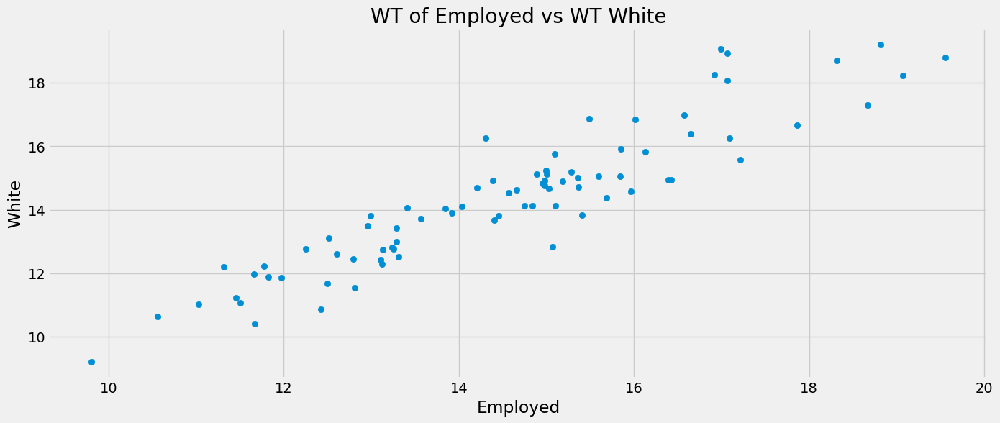

In [18]:
plt.figure(figsize=(15,6))

plt.scatter(x= WTdemos['WT: Employed'], y= WTdemos['WT: In Poverty'])
plt.xlabel("Employed")
plt.ylabel("White")
plt.title('WT of Employed vs WT White')
plt.show()

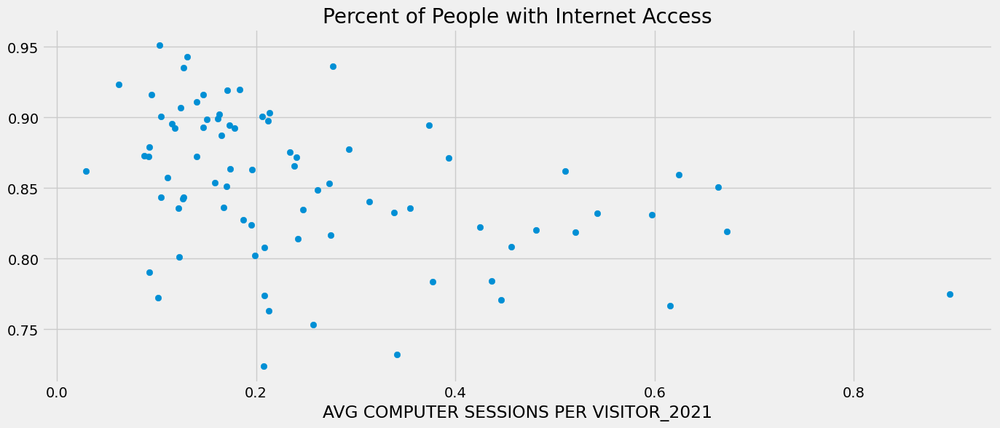

In [55]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2021'], y= corrMatrixInfo['Percent of People with Internet Access'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2021')
plt.title('Percent of People with Internet Access')
plt.show()

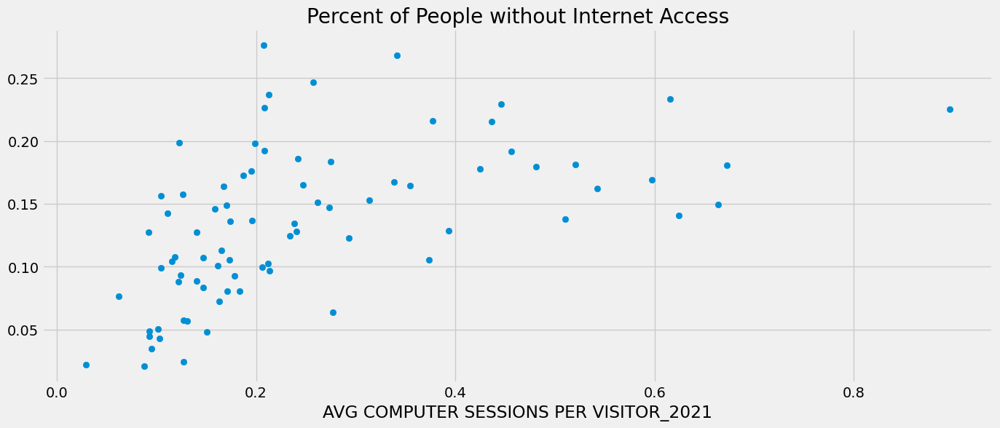

In [56]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2021'], y= corrMatrixInfo['Percent of People without Internet Access'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2021')
plt.title('Percent of People without Internet Access')
plt.show()

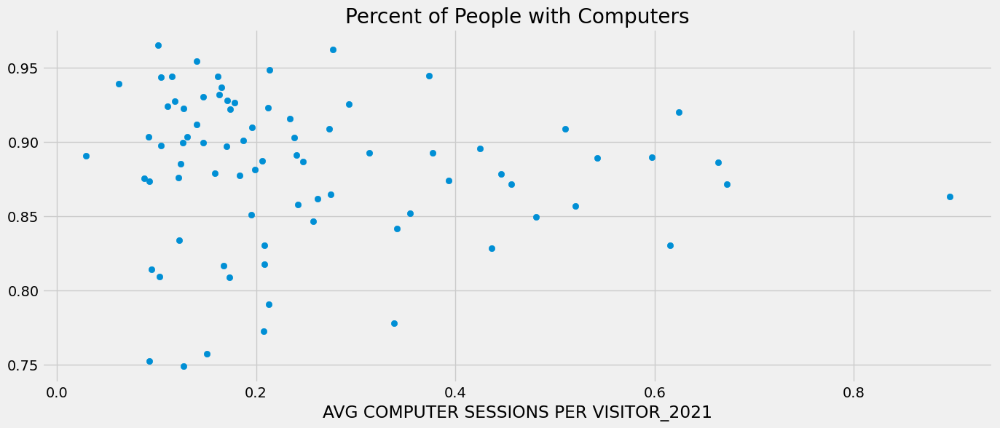

In [63]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2021'], y= corrMatrixInfo['Percent of People with Computers'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2021')
plt.title('Percent of People with Computers')
plt.show()

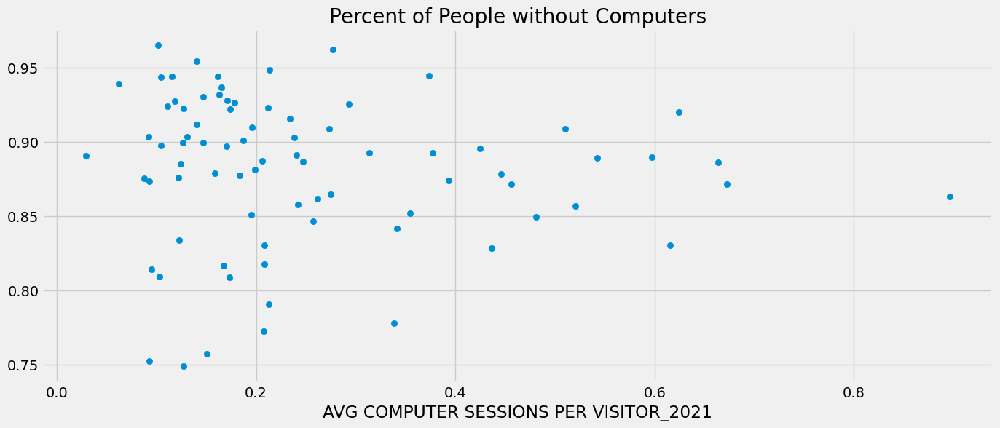

In [64]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2021'], y= corrMatrixInfo['Percent of People with Computers'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2021')
plt.title('Percent of People without Computers')
plt.show()

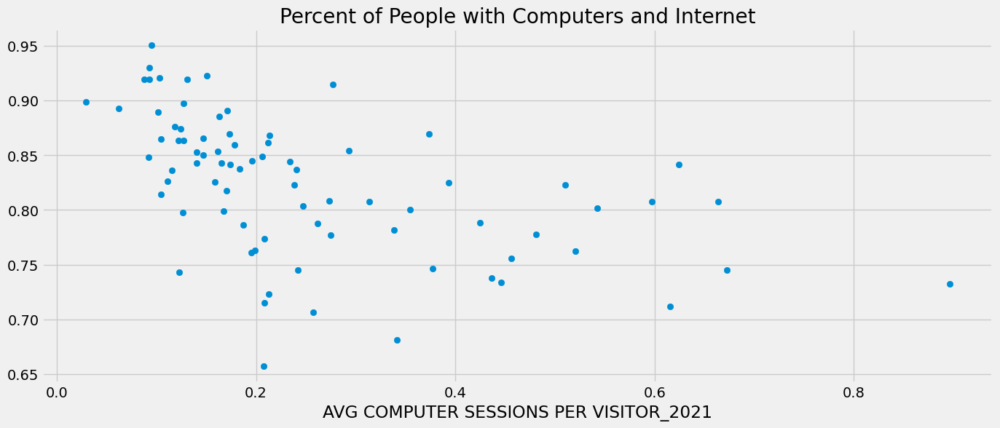

In [70]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2021'], y= corrMatrixInfo['Percent of People with Computers and Internet'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2021')
plt.title('Percent of People with Computers and Internet')
plt.show()

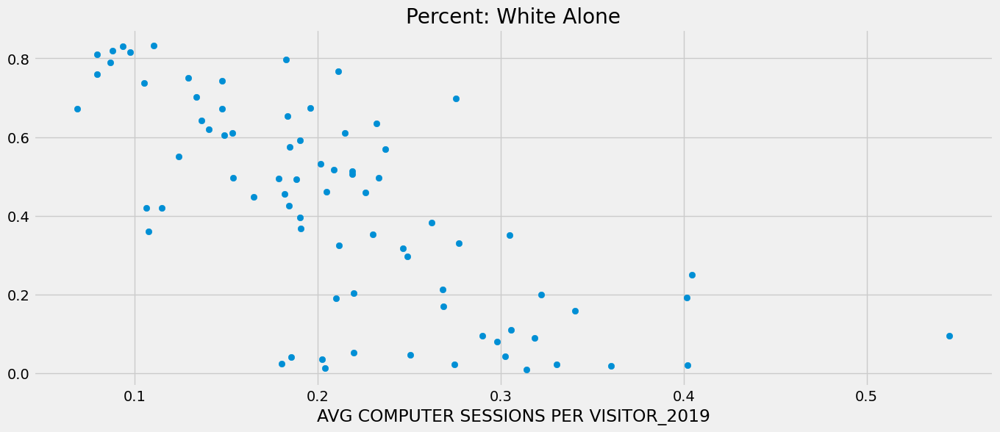

In [31]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2019'], y= corrMatrixInfo['Percent: White Alone'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2019')
plt.title('Percent: White Alone')
plt.show()

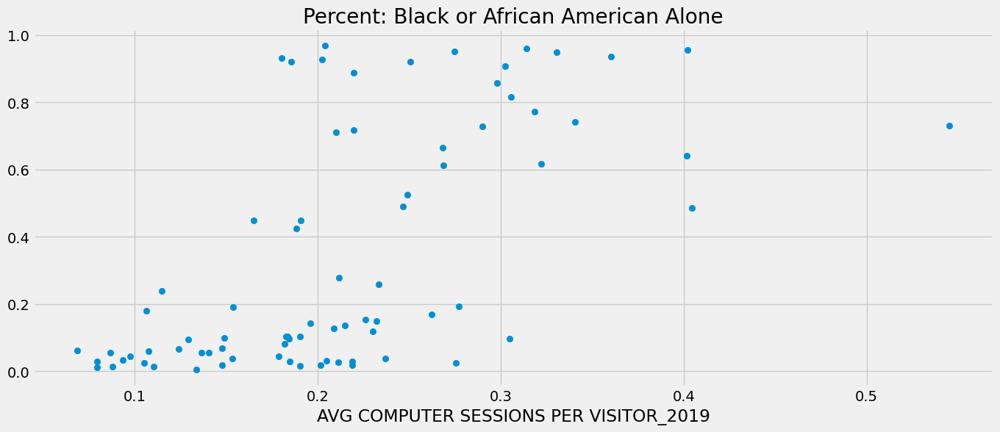

In [32]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2019'], y= corrMatrixInfo['Percent: Black or African American Alone'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2019')
plt.title('Percent: Black or African American Alone')
plt.show()

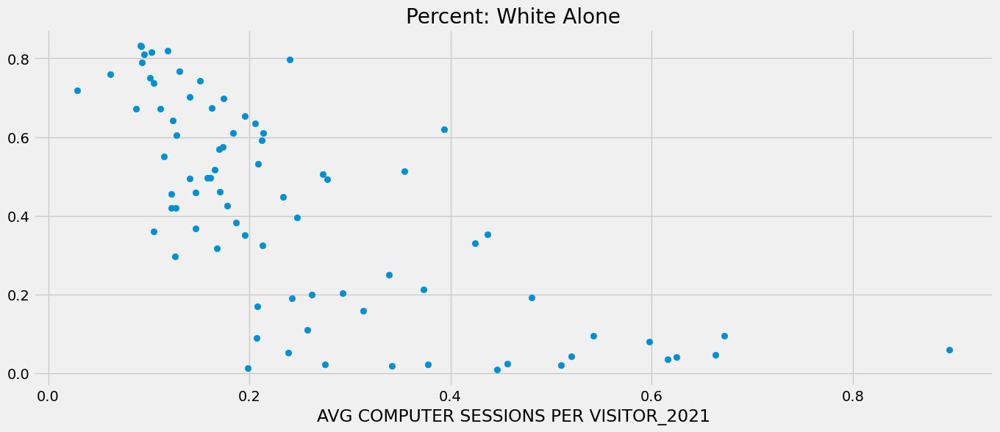

In [33]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2021'], y= corrMatrixInfo['Percent: White Alone'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2021')
plt.title('Percent: White Alone')
plt.show()

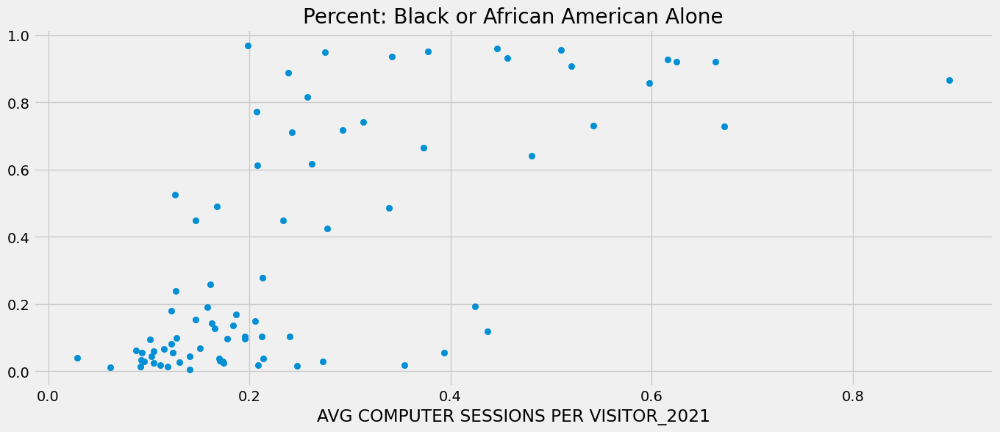

In [34]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2021'], y= corrMatrixInfo['Percent: Black or African American Alone'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2021')
plt.title('Percent: Black or African American Alone')
plt.show()

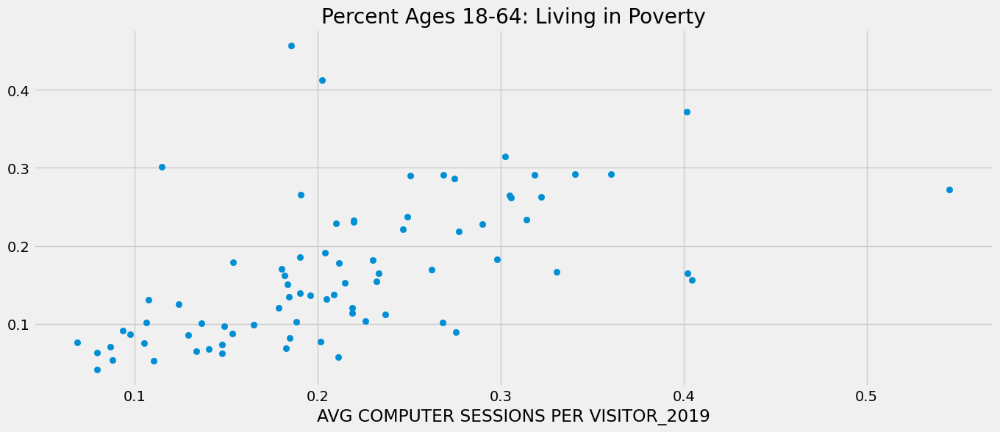

In [42]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2019'], y= corrMatrixInfo['Percent Ages 18-64: Living in Poverty'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2019')
plt.title('Percent Ages 18-64: Living in Poverty')
plt.show()

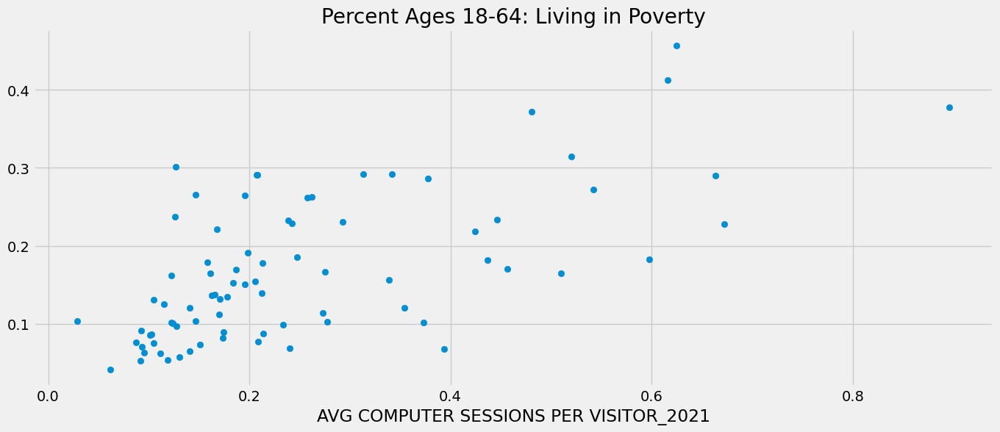

In [41]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2021'], y= corrMatrixInfo['Percent Ages 18-64: Living in Poverty'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2021')
plt.title('Percent Ages 18-64: Living in Poverty')
plt.show()

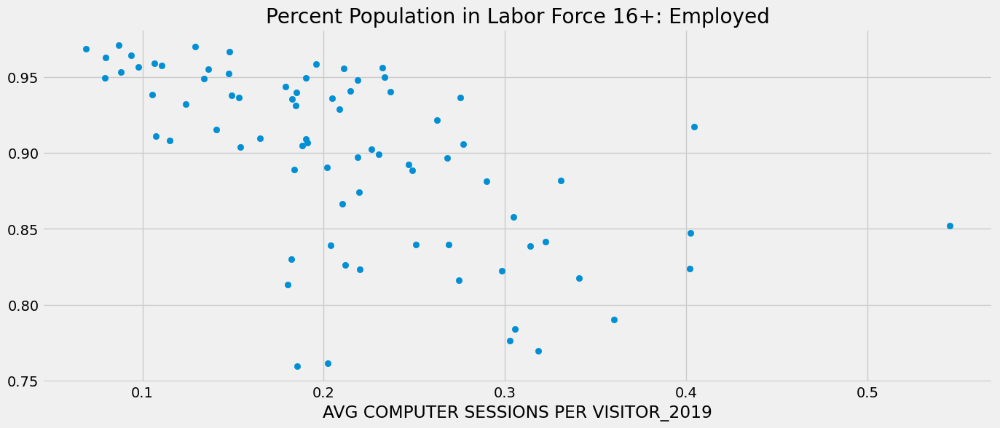

In [45]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2019'], y= corrMatrixInfo['Percent Population in Labor Force 16+: Employed'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2019')
plt.title('Percent Population in Labor Force 16+: Employed')
plt.show()

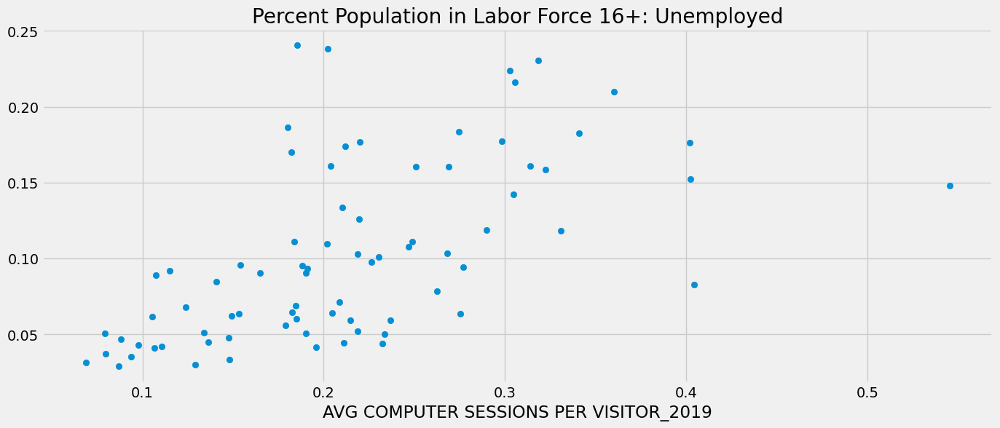

In [46]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2019'], y= corrMatrixInfo['Percent Population in Labor Force 16+: Unemployed'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2019')
plt.title('Percent Population in Labor Force 16+: Unemployed')
plt.show()

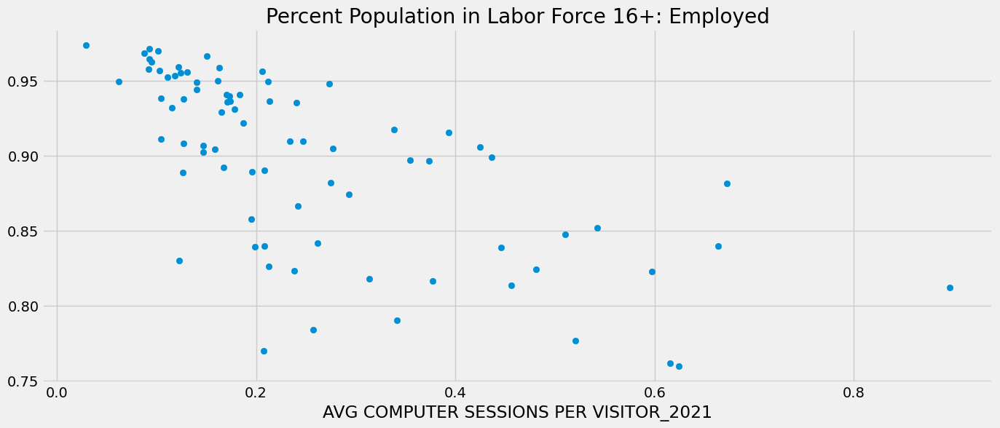

In [47]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2021'], y= corrMatrixInfo['Percent Population in Labor Force 16+: Employed'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2021')
plt.title('Percent Population in Labor Force 16+: Employed')
plt.show()

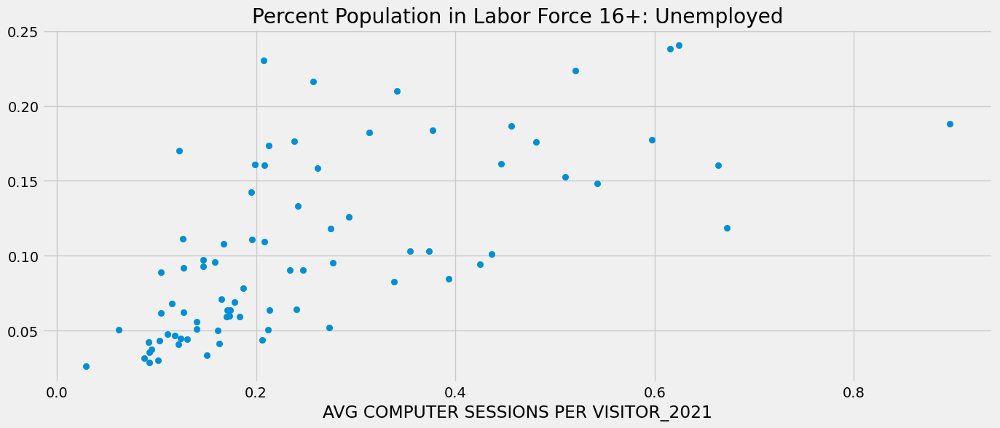

In [48]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG COMPUTER SESSIONS PER VISITOR_2021'], y= corrMatrixInfo['Percent Population in Labor Force 16+: Unemployed'])
plt.xlabel('AVG COMPUTER SESSIONS PER VISITOR_2021')
plt.title('Percent Population in Labor Force 16+: Unemployed')
plt.show()

###### Internet

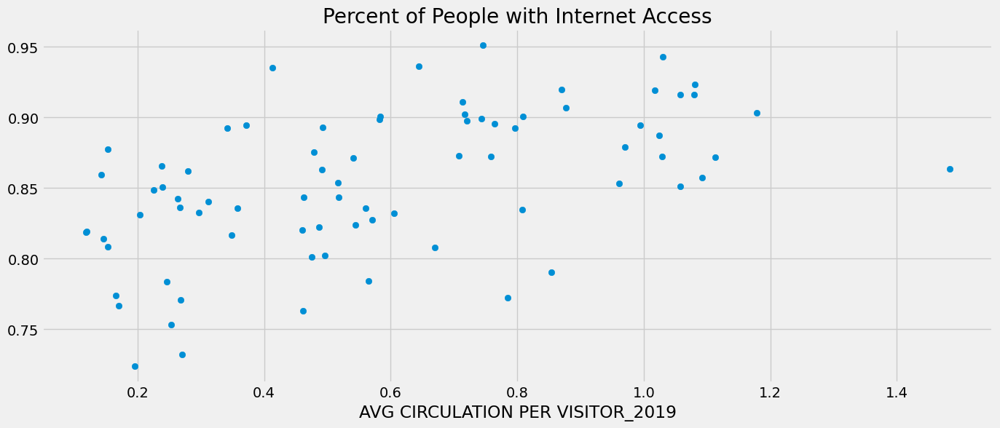

In [57]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2019'], y= corrMatrixInfo['Percent of People with Internet Access'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2019')
plt.title('Percent of People with Internet Access')
plt.show()

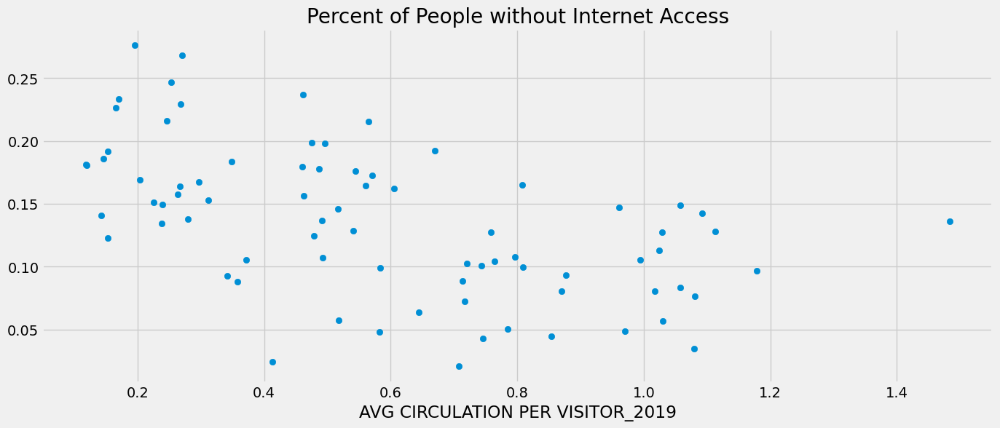

In [58]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2019'], y= corrMatrixInfo['Percent of People without Internet Access'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2019')
plt.title('Percent of People without Internet Access')
plt.show()

###### Computers

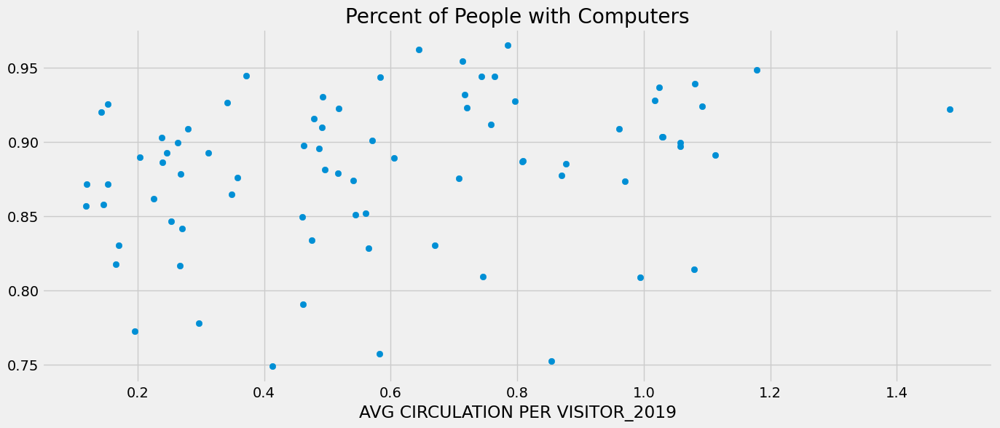

In [65]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2019'], y= corrMatrixInfo['Percent of People with Computers'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2019')
plt.title('Percent of People with Computers')
plt.show()

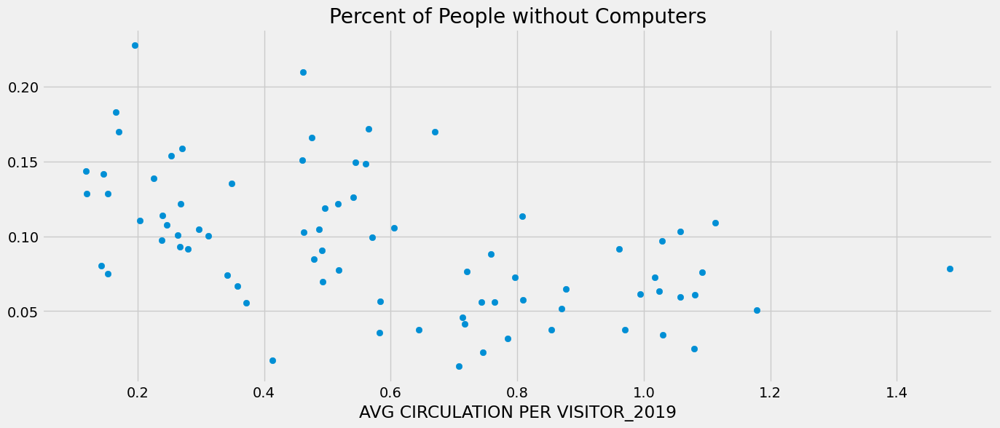

In [66]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2019'], y= corrMatrixInfo['Percent of People without Computers'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2019')
plt.title('Percent of People without Computers')
plt.show()

###### Computers and Internet

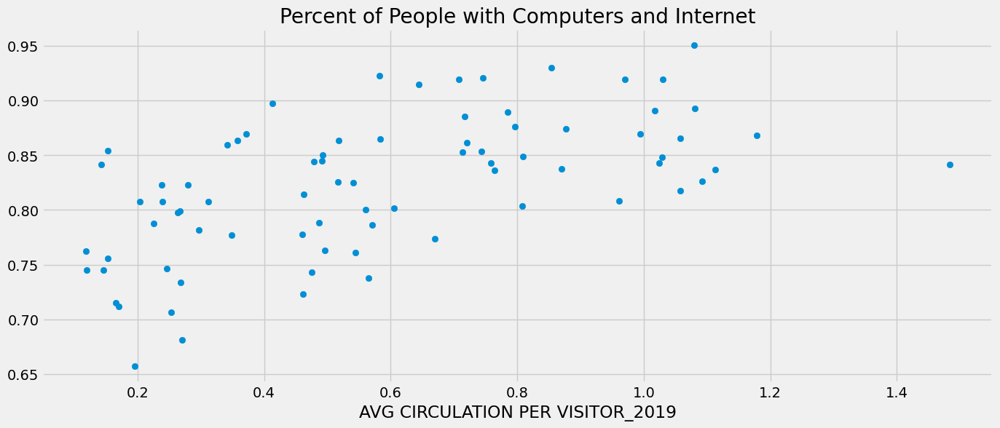

In [71]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2019'], y= corrMatrixInfo['Percent of People with Computers and Internet'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2019')
plt.title('Percent of People with Computers and Internet')
plt.show()

###### Internet

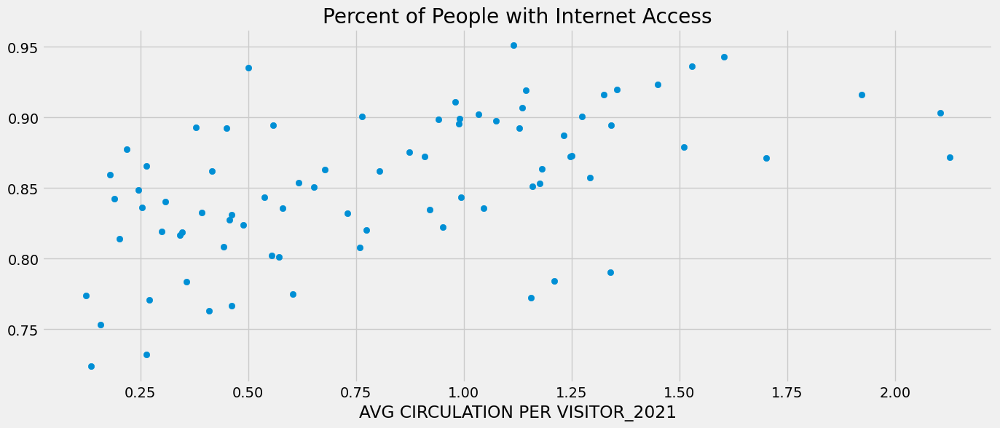

In [59]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2021'], y= corrMatrixInfo['Percent of People with Internet Access'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2021')
plt.title('Percent of People with Internet Access')
plt.show()

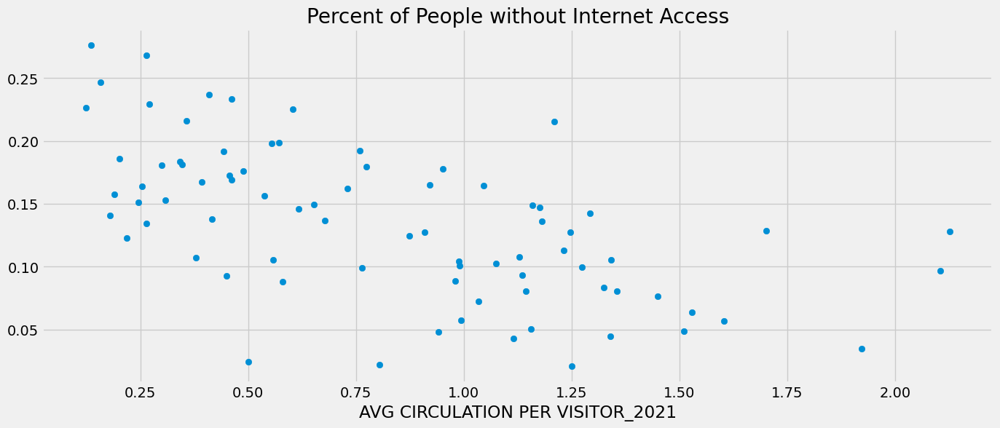

In [60]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2021'], y= corrMatrixInfo['Percent of People without Internet Access'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2021')
plt.title('Percent of People without Internet Access')
plt.show()

###### Computers

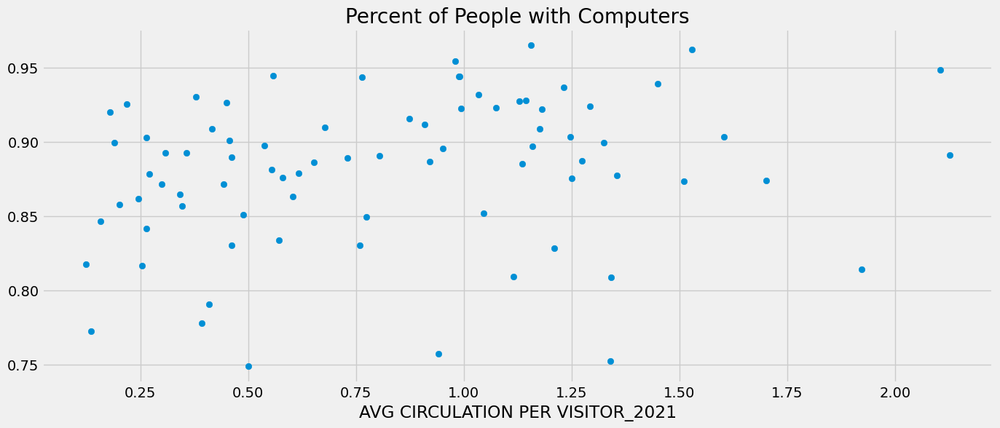

In [67]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2021'], y= corrMatrixInfo['Percent of People with Computers'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2021')
plt.title('Percent of People with Computers')
plt.show()

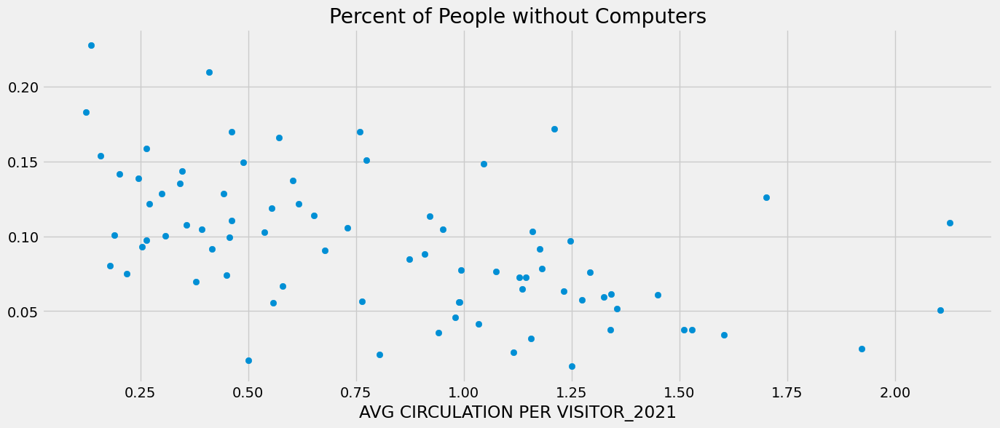

In [68]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2021'], y= corrMatrixInfo['Percent of People without Computers'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2021')
plt.title('Percent of People without Computers')
plt.show()

###### Computers and Internet

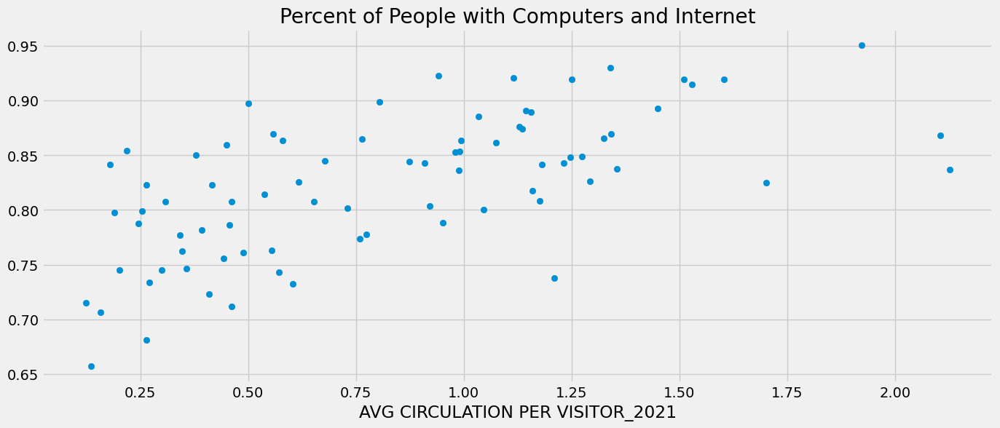

In [72]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2021'], y= corrMatrixInfo['Percent of People with Computers and Internet'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2021')
plt.title('Percent of People with Computers and Internet')
plt.show()

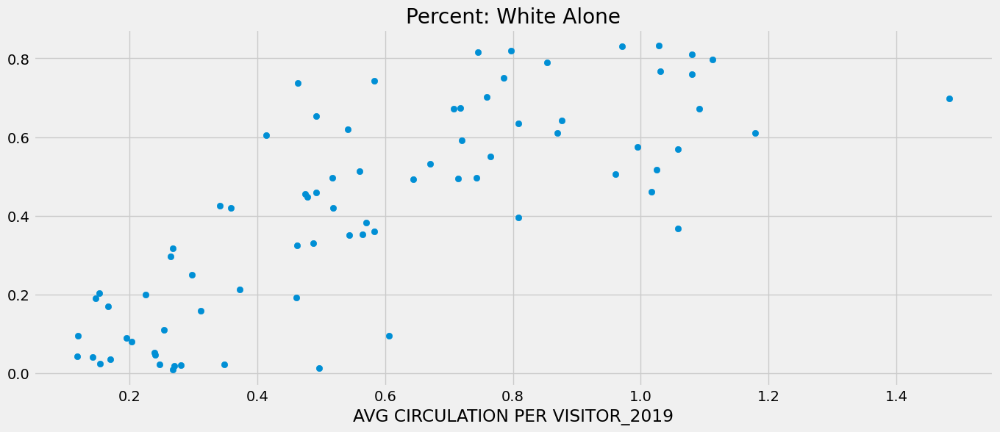

In [35]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2019'], y= corrMatrixInfo['Percent: White Alone'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2019')
plt.title('Percent: White Alone')
plt.show()

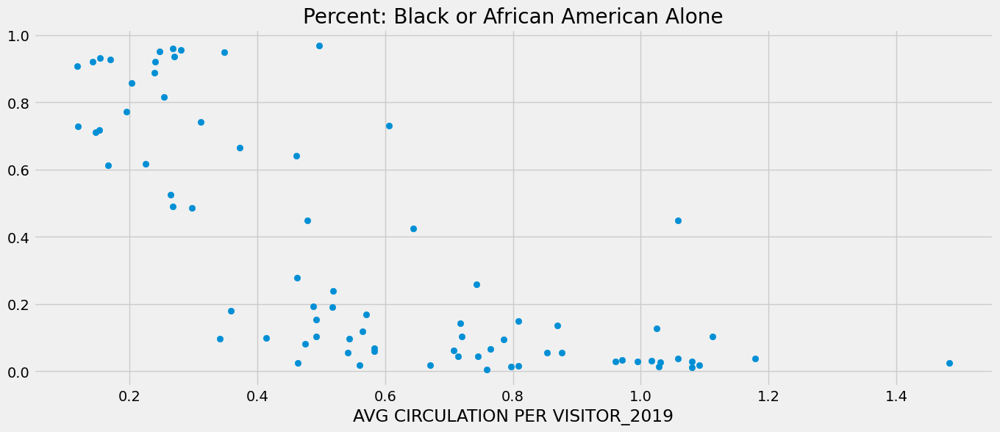

In [36]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2019'], y= corrMatrixInfo['Percent: Black or African American Alone'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2019')
plt.title('Percent: Black or African American Alone')
plt.show()

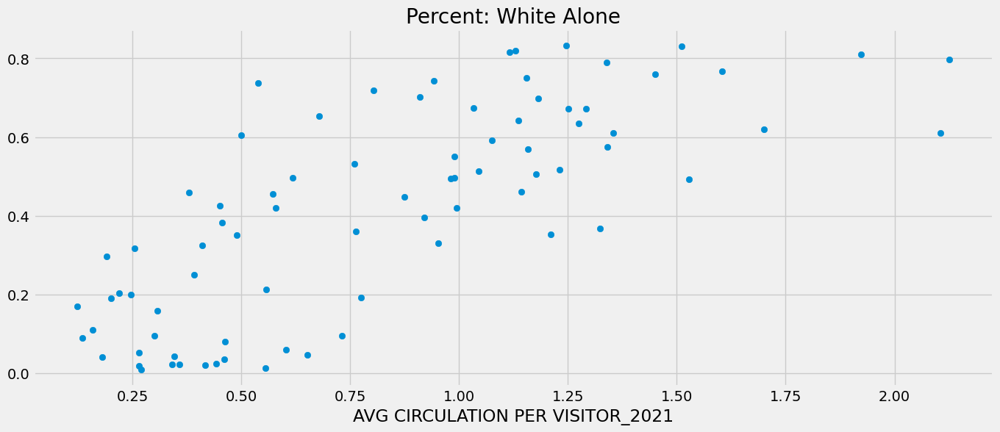

In [37]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2021'], y= corrMatrixInfo['Percent: White Alone'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2021')
plt.title('Percent: White Alone')
plt.show()

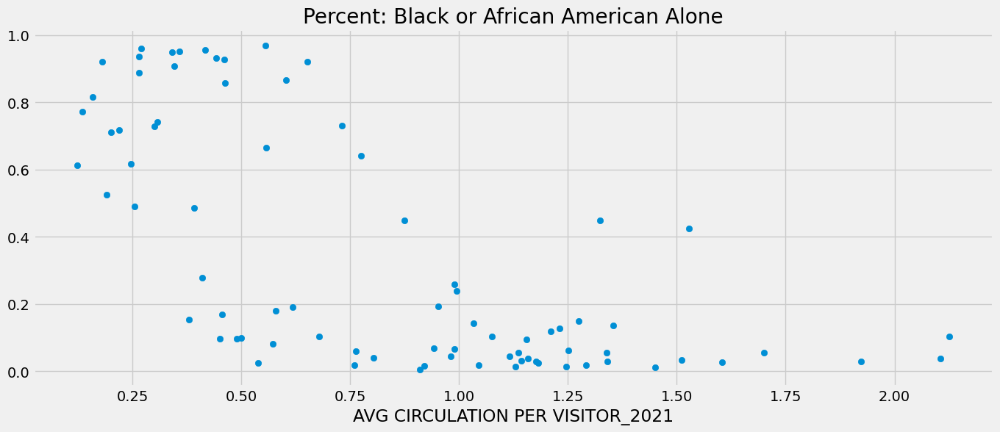

In [38]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2021'], y= corrMatrixInfo['Percent: Black or African American Alone'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2021')
plt.title('Percent: Black or African American Alone')
plt.show()

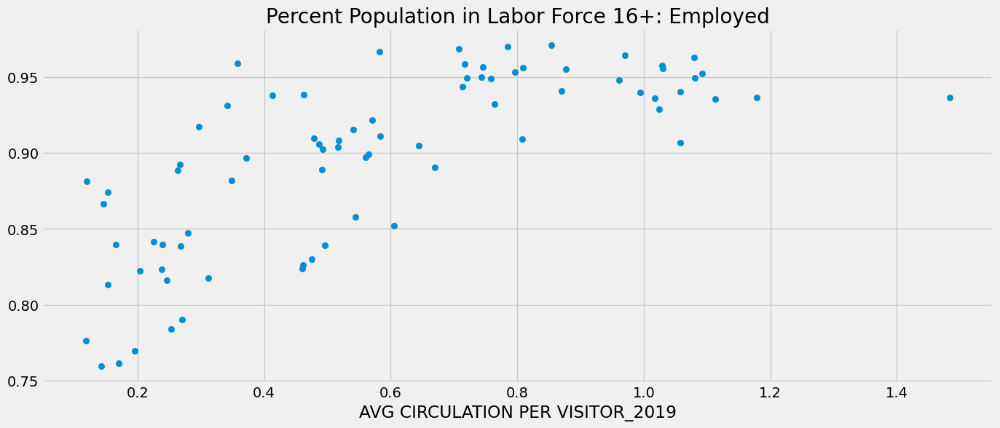

In [49]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2019'], y= corrMatrixInfo['Percent Population in Labor Force 16+: Employed'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2019')
plt.title('Percent Population in Labor Force 16+: Employed')
plt.show()

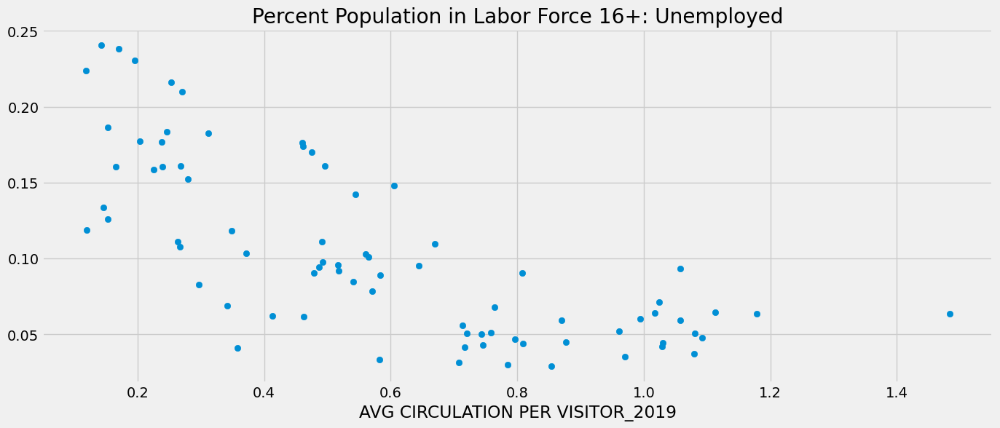

In [50]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2019'], y= corrMatrixInfo['Percent Population in Labor Force 16+: Unemployed'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2019')
plt.title('Percent Population in Labor Force 16+: Unemployed')
plt.show()

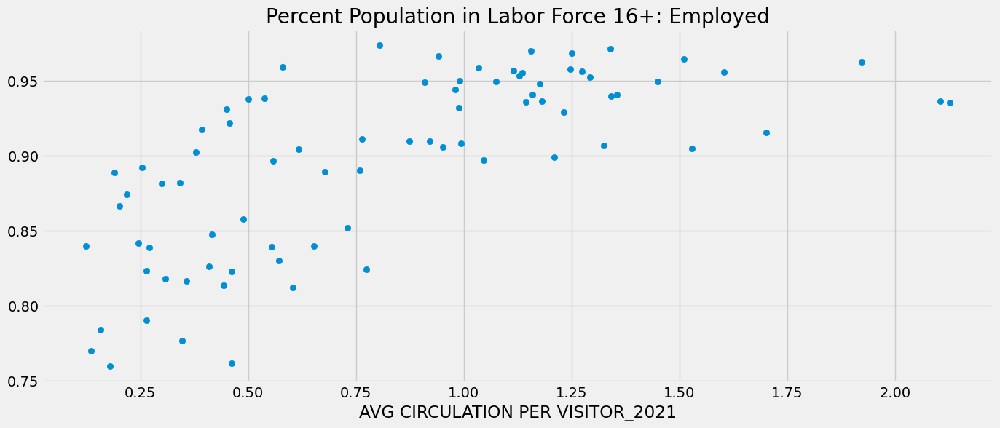

In [51]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2021'], y= corrMatrixInfo['Percent Population in Labor Force 16+: Employed'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2021')
plt.title('Percent Population in Labor Force 16+: Employed')
plt.show()

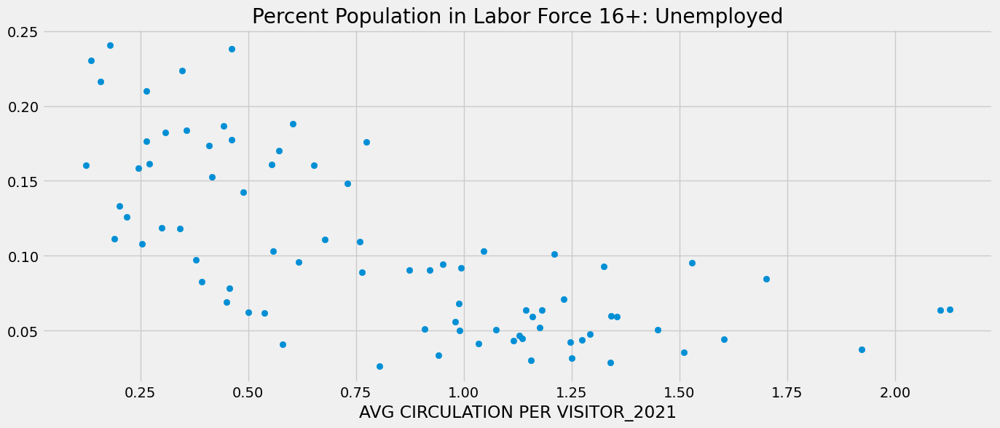

In [52]:
plt.figure(figsize=(15,6))

plt.scatter(x= corrMatrixInfo['AVG CIRCULATION PER VISITOR_2021'], y= corrMatrixInfo['Percent Population in Labor Force 16+: Unemployed'])
plt.xlabel('AVG CIRCULATION PER VISITOR_2021')
plt.title('Percent Population in Labor Force 16+: Unemployed')
plt.show()

In [20]:
corrMatrixInfo.columns

Index(['CIRCULATION_2019', 'COMPUTER SESSIONS_2019', 'VISITORS_2019',
       'AVG COMPUTER SESSIONS PER VISITOR_2019',
       'AVG CIRCULATION PER VISITOR_2019', 'CIRCULATION_2021',
       'COMPUTER SESSIONS_2021', 'VISITORS_2021',
       'AVG COMPUTER SESSIONS PER VISITOR_2021',
       'AVG CIRCULATION PER VISITOR_2021', 'AVG WALKING TIME (MIN)',
       'Percent of People with Internet Access',
       'Percent of People without Internet Access',
       'Percent of People with Computers',
       'Percent of People without Computers',
       'Percent of People with Computers and Internet',
       'Percent Population in Labor Force 16+: Employed',
       'Percent Population in Labor Force 16+: Unemployed',
       'Percent Households: Less Than $10,000',
       'Percent Households: $10,000 to $14,999',
       'Percent Households: $15,000 to $19,999',
       'Percent Households: $20,000 to $24,999',
       'Percent Households: $25,000 to $29,999',
       'Percent Households: $30,000 to $34

In [21]:
corrMatrixInfo = corrMatrixInfo.sort_values(by = 'AVG WALKING TIME (MIN)')

In [22]:
corrMatrixInfo

,CIRCULATION_2019,COMPUTER SESSIONS_2019,VISITORS_2019,AVG COMPUTER SESSIONS PER VISITOR_2019,AVG CIRCULATION PER VISITOR_2019,CIRCULATION_2021,COMPUTER SESSIONS_2021,VISITORS_2021,AVG COMPUTER SESSIONS PER VISITOR_2021,AVG CIRCULATION PER VISITOR_2021,...,Percent: 75 to 79 years,Percent: 80 to 84 years,Percent: 85 years and over,Percent: 25+ Less Than High School,Percent: 25+ High School or More,Percent: 25+ Some College or More,Percent: 25+ Bachelor's Degree or More,Percent: 25+ Master's Degree or More,Percent: 25+ Professional School Degree or More,Percent: 25+ Doctorate Degree
Branch,,,,,,,,,,,,,,,,,,,,,
Little Italy,61193.0,13579.0,118051.0,0.115027,0.518361,47793.0,6112.0,48093.0,0.127087,0.993762,...,0.011189,0.006513,0.024269,0.070990,0.929010,0.824188,0.670238,0.342967,0.147921,0.075443
Chicago Bee,10925.0,9523.0,23708.0,0.401679,0.460815,7891.0,4898.0,10188.0,0.480762,0.774539,...,0.027926,0.018255,0.026133,0.170438,0.829562,0.573276,0.287220,0.116068,0.036794,0.013925
Edgewater,171399.0,42300.0,197045.0,0.214672,0.869847,127737.0,17329.0,94307.0,0.183751,1.354481,...,0.026003,0.013582,0.018243,0.084178,0.915822,0.774853,0.564579,0.250838,0.071809,0.027090
Bucktown-Wicker Park,109420.0,11122.0,128142.0,0.086794,0.853896,89707.0,6219.0,66986.0,0.092840,1.339190,...,0.008802,0.004797,0.006170,0.038270,0.961730,0.882950,0.780220,0.318048,0.114118,0.028518
Humboldt Park,56569.0,14942.0,78546.0,0.190232,0.720202,36649.0,7233.0,34092.0,0.212161,1.075003,...,0.008662,0.008776,0.007505,0.139292,0.860708,0.663163,0.473197,0.161625,0.047810,0.012477
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Roden,72925.0,7840.0,70882.0,0.110606,1.028823,49569.0,3651.0,39766.0,0.091812,1.246517,...,0.031369,0.025207,0.040134,0.059071,0.940929,0.711743,0.489565,0.190196,0.050158,0.017460
Walker,15678.0,5404.0,32753.0,0.164993,0.478674,10541.0,2816.0,12055.0,0.233596,0.874409,...,0.019641,0.024685,0.024255,0.090556,0.909444,0.692255,0.361562,0.159638,0.031962,0.012954
Altgeld,4014.0,5226.0,28196.0,0.185345,0.142361,1934.0,6719.0,10760.0,0.624442,0.179740,...,0.006495,0.006306,0.009861,0.131738,0.868262,0.514783,0.081321,0.035143,0.001320,0.000387


In [48]:
corrMatrixInfoTop = corrMatrixInfo.iloc[0:8, :]

In [49]:
corrMatrixInfoBottom = corrMatrixInfo.iloc[73:81, :]

In [50]:
corrMatrixInfoTruncated = corrMatrixInfoTop.copy(deep = True)

In [51]:
corrMatrixInfoTruncated = pd.concat([corrMatrixInfoTruncated, corrMatrixInfoBottom])

In [52]:
corrMatrixInfoTruncated

,CIRCULATION_2019,COMPUTER SESSIONS_2019,VISITORS_2019,AVG COMPUTER SESSIONS PER VISITOR_2019,AVG CIRCULATION PER VISITOR_2019,CIRCULATION_2021,COMPUTER SESSIONS_2021,VISITORS_2021,AVG COMPUTER SESSIONS PER VISITOR_2021,AVG CIRCULATION PER VISITOR_2021,...,Percent: 75 to 79 years,Percent: 80 to 84 years,Percent: 85 years and over,Percent: 25+ Less Than High School,Percent: 25+ High School or More,Percent: 25+ Some College or More,Percent: 25+ Bachelor's Degree or More,Percent: 25+ Master's Degree or More,Percent: 25+ Professional School Degree or More,Percent: 25+ Doctorate Degree
Branch,,,,,,,,,,,,,,,,,,,,,
Little Italy,61193.0,13579.0,118051.0,0.115027,0.518361,47793.0,6112.0,48093.0,0.127087,0.993762,...,0.011189,0.006513,0.024269,0.070990,0.929010,0.824188,0.670238,0.342967,0.147921,0.075443
Chicago Bee,10925.0,9523.0,23708.0,0.401679,0.460815,7891.0,4898.0,10188.0,0.480762,0.774539,...,0.027926,0.018255,0.026133,0.170438,0.829562,0.573276,0.287220,0.116068,0.036794,0.013925
Edgewater,171399.0,42300.0,197045.0,0.214672,0.869847,127737.0,17329.0,94307.0,0.183751,1.354481,...,0.026003,0.013582,0.018243,0.084178,0.915822,0.774853,0.564579,0.250838,0.071809,0.027090
Bucktown-Wicker Park,109420.0,11122.0,128142.0,0.086794,0.853896,89707.0,6219.0,66986.0,0.092840,1.339190,...,0.008802,0.004797,0.006170,0.038270,0.961730,0.882950,0.780220,0.318048,0.114118,0.028518
Humboldt Park,56569.0,14942.0,78546.0,0.190232,0.720202,36649.0,7233.0,34092.0,0.212161,1.075003,...,0.008662,0.008776,0.007505,0.139292,0.860708,0.663163,0.473197,0.161625,0.047810,0.012477
Water Works,NaN,NaN,NaN,NaN,NaN,8516.0,306.0,10594.0,0.028884,0.803851,...,0.027358,0.016356,0.020095,0.010421,0.989579,0.951998,0.865238,0.448610,0.193363,0.053186
West Town,59889.0,15214.0,102826.0,0.147959,0.582431,45464.0,7276.0,48278.0,0.150710,0.941713,...,0.007910,0.006681,0.003895,0.043311,0.956689,0.882720,0.755561,0.289658,0.093000,0.028663
Bezazian,98356.0,28234.0,121571.0,0.232243,0.809042,55646.0,8997.0,43661.0,0.206065,1.274501,...,0.019701,0.025368,0.026799,0.085182,0.914818,0.799065,0.604571,0.266354,0.073455,0.026757
Oriole Park,65208.0,7202.0,81829.0,0.088013,0.796881,56191.0,5912.0,49780.0,0.118763,1.128787,...,0.029606,0.020861,0.025072,0.082047,0.917953,0.687570,0.429350,0.167071,0.032311,0.012047


In [58]:
corrMatrixInfoTruncatedHalf = corrMatrixInfoTruncated.corr().iloc[0:11, 12:58]

In [54]:
corrMatrixInfoTruncatedHalf

,Percent of People without Internet Access,Percent of People with Computers,Percent of People without Computers,Percent of People with Computers and Internet,Percent Population in Labor Force 16+: Employed,Percent Population in Labor Force 16+: Unemployed,"Percent Households: Less Than $10,000","Percent Households: $10,000 to $14,999","Percent Households: $15,000 to $19,999","Percent Households: $20,000 to $24,999",...,"Percent Workers 16+: Car, Truck, or Van",Percent Workers 16+: Drove Alone,Percent Workers 16+: Carpooled,Percent Workers 16+: Public Transportation (Includes Taxi),Percent Workers 16+: Motorcycle,Percent Workers 16+: Bicycle,Percent Workers 16+: Walked,Percent Workers 16+: Other Means,Percent: White Alone,Percent: Black or African American Alone
CIRCULATION_2019,-0.626919,-0.320945,-0.582652,0.377827,0.664511,-0.664511,-0.443468,-0.169738,-0.387000,0.003755,...,-0.544793,-0.499436,-0.625242,0.488945,0.488602,0.462996,0.138301,-0.476625,0.568042,-0.572224
COMPUTER SESSIONS_2019,-0.205350,-0.130782,-0.291716,-0.120154,0.173327,-0.173327,-0.159491,0.198239,-0.226183,0.370024,...,-0.489676,-0.488324,-0.277339,0.567868,0.117420,0.364772,0.135393,-0.205733,-0.032432,-0.030686
VISITORS_2019,-0.665417,-0.340114,-0.625380,0.378671,0.520107,-0.520107,-0.383128,-0.144560,-0.377226,0.143284,...,-0.646013,-0.619004,-0.548045,0.566521,0.323143,0.557207,0.322834,-0.332650,0.336103,-0.383281
AVG COMPUTER SESSIONS PER VISITOR_2019,0.668189,0.057590,0.629370,-0.792924,-0.572248,0.572248,0.449067,0.805278,0.207222,0.332852,...,-0.037588,-0.092667,0.377217,0.224360,-0.383139,-0.081959,-0.039348,0.393233,-0.640502,0.580222
AVG CIRCULATION PER VISITOR_2019,-0.364451,-0.160561,-0.211803,0.298128,0.812506,-0.812506,-0.626277,-0.375057,-0.375621,-0.406980,...,-0.049124,0.018382,-0.514333,-0.082190,0.588301,0.180255,-0.151272,-0.640695,0.867239,-0.799751
CIRCULATION_2021,-0.453409,-0.362362,-0.411961,0.339633,0.559758,-0.559758,-0.411060,-0.145784,-0.331574,0.036374,...,-0.366409,-0.338211,-0.433513,0.438265,0.451815,0.434363,-0.098307,-0.498985,0.515635,-0.508731
COMPUTER SESSIONS_2021,0.005371,-0.134405,-0.108696,-0.159793,-0.050401,0.050401,0.029967,0.284688,-0.128907,0.491747,...,-0.226371,-0.247893,0.012792,0.552239,0.095965,0.306260,-0.272945,-0.298453,-0.157751,0.115627
VISITORS_2021,-0.499499,-0.334196,-0.482855,0.392795,0.519570,-0.519570,-0.414628,-0.185096,-0.312241,0.033072,...,-0.355160,-0.348993,-0.267689,0.431032,0.447316,0.466174,-0.100136,-0.456592,0.437170,-0.497901
AVG COMPUTER SESSIONS PER VISITOR_2021,0.735771,0.122100,0.602137,-0.662732,-0.914379,0.914379,0.761602,0.657106,0.305942,0.565232,...,0.226771,0.181062,0.471926,0.130444,-0.472499,-0.303005,-0.284908,0.247876,-0.871964,0.947053
AVG CIRCULATION PER VISITOR_2021,-0.236366,-0.222216,-0.054888,0.181123,0.646230,-0.646230,-0.516521,-0.250935,-0.377473,-0.229180,...,-0.063359,0.002604,-0.515144,-0.033720,0.296047,0.237100,-0.092657,-0.501453,0.699365,-0.592610


In [59]:
fig = plt.figure(figsize=(48,6), dpi = 480)
sns.heatmap(corrMatrixInfoTruncatedHalf, annot=True, fmt = '.3f')

plt.show()

In [60]:
corrMatrixInfoTruncatedSecondHalf = corrMatrixInfoTruncated.corr().iloc[0:11, 58:]

In [61]:
fig = plt.figure(figsize=(48,6), dpi = 480)
sns.heatmap(corrMatrixInfoTruncatedSecondHalf, annot=True, fmt = '.3f')

plt.show()

In [62]:
# maybe add cycling as another row in the df